In [21]:
import pandas as pd
from matplotlib import pyplot as plt

In [6]:
df = pd.read_csv('ResultsData_080623.csv') 
df = df.rename(columns={"Unnamed: 0": "Index"})

# Display Images

In [7]:
# Finding rows where Column1 is not equal to Column2
result = df[(df['m1'] == df['m3']) & (df['label'] != df['m3'])]

print(result['img_path'][12])

../../data/val/YFCC100M/v_9c29a4c4e03790d16925f984e838e4a/frame0776.jpg


In [10]:
sample = result[0:1]
sample

,Index,x0,x1,x2,x3,x4,x5,x6,x7,x8,...,original_label,img_path,metadata,bboxs,m1,m2,m3,m4,m5,m6
12,52,1.000325,2.06531,1.039215,1.99837,1.916962,1.118734,2.048513,3.884789,4.146286,...,person,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[209, 2, 640, 2, 640, 480, 2...","(209.0, 2.0, 640.0, 480.0)",not_person,person,not_person,person,person,person


In [16]:
image_path = sample['img_path'].item()
print(image_path)

../../data/val/YFCC100M/v_9c29a4c4e03790d16925f984e838e4a/frame0776.jpg


In [29]:
# Filter the DataFrame to get the row with the specified image path
result_row = df[df['img_path'] == image_path]

# Print the resulting row of information
print(result_row)

    Index        x0        x1        x2       x3        x4        x5  \
12     52  1.000325  2.065310  1.039215  1.99837  1.916962  1.118734   
13     53  0.365898  0.438105  0.467028  0.63931  1.671560  0.705191   

          x6        x7        x8  ...  original_label  \
12  2.048513  3.884789  4.146286  ...          person   
13  0.474622  0.592173  1.743129  ...         spatula   

                                             img_path  \
12  ../../data/val/YFCC100M/v_9c29a4c4e03790d16925...   
13  ../../data/val/YFCC100M/v_9c29a4c4e03790d16925...   

                                             metadata  \
12  {'segmentation': [[209, 2, 640, 2, 640, 480, 2...   
13  {'segmentation': [[213, 38, 247, 38, 247, 355,...   

                          bboxs          m1          m2          m3  \
12   (209.0, 2.0, 640.0, 480.0)  not_person      person  not_person   
13  (213.0, 38.0, 247.0, 355.0)  not_person  not_person  not_person   

            m4          m5          m6  
12      pers

In [17]:
pil_bbox = sample['bboxs'].item()
print((pil_bbox))

(209.0, 2.0, 640.0, 480.0)


In [18]:
elements = pil_bbox.strip("()").split(", ")

# Step 2: Convert each element to an integer
pil_bbox = tuple(int(float(element)) for element in elements)
print((pil_bbox))

(209, 2, 640, 480)


In [19]:
label = sample['label'].item()
print(label)

person


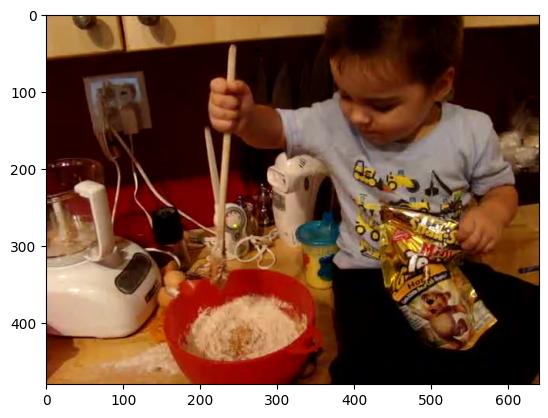

In [22]:
from PIL import Image, ImageDraw,ImageFont
%matplotlib inline

fontsize = 30
font = ImageFont.truetype("arial.ttf", fontsize)

image = Image.open(image_path)
roi = image.crop(pil_bbox)
draw = ImageDraw.Draw(roi)
draw.text((30, 30), label, fill='red')
plt.imshow(image)

C:\Users\monic\AppData\Local\Temp\ipykernel_19892\1767497003.py:13: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(label, font=font)


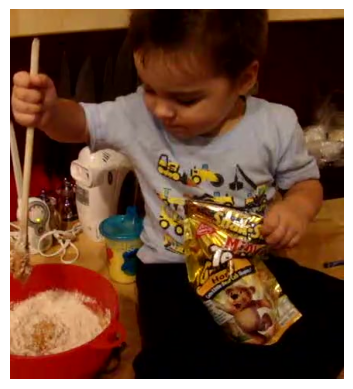

In [23]:
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt

fontsize = 12
font = ImageFont.truetype("arial.ttf", fontsize)

image = Image.open(image_path)
roi = image.crop(pil_bbox)
draw = ImageDraw.Draw(roi)

# Calculate text size and position
label = "M9: Not Person"
text_width, text_height = draw.textsize(label, font=font)
text_x = 5
text_y = 14

# Calculate background rectangle size
padding = 5
bg_width = text_width + 2 * padding
bg_height = text_height + 2 * padding

# Draw white background rectangle
# draw.rectangle([(text_x - padding, text_y - padding), (text_x + bg_width, text_y + bg_height)], fill='white')

# Draw the text on the image with a red color
# draw.text((text_x, text_y), label, fill='red', font=font)

# Show the image
plt.imshow(roi)
plt.axis('off')
plt.show()

In [25]:
import pickle

In [27]:
val = pickle.load(open('validation_df_072523.pkl','rb'))

In [28]:
val

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,...,x253,x254,x255,original_label,label,time,vid_id,img_path,meta_data,bboxs
0,0.809772,2.011964,0.665916,1.290630,2.376112,1.160442,1.986653,3.324161,3.335070,1.656441,...,0.981368,3.213875,1.042644,person,person,0,0,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[239, 2, 640, 2, 640, 480, 2...","(239.0, 2.0, 640.0, 480.0)"
1,0.209809,-0.195299,0.613611,0.511834,1.189655,0.393342,-0.076997,0.543957,0.709552,0.709502,...,0.025795,-0.163690,-0.231799,spatula,not_person,0,0,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[254, 187, 277, 187, 277, 42...","(254.0, 187.0, 277.0, 423.0)"
2,0.855329,2.108072,0.876133,1.264734,2.397485,1.067511,2.214559,3.314182,3.469054,1.742077,...,0.887878,2.643020,1.344221,person,person,1,0,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[239, 2, 640, 2, 640, 480, 2...","(239.0, 2.0, 640.0, 480.0)"
3,0.202437,-0.188921,0.578980,0.430455,1.180157,0.347612,-0.034450,0.569040,0.682533,0.740023,...,0.042143,-0.168623,-0.219340,spatula,not_person,1,0,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[254, 187, 277, 187, 277, 41...","(254.0, 187.0, 277.0, 417.0)"
4,1.044030,1.565419,0.786089,0.992461,2.322093,1.358161,1.722431,2.644401,3.255550,1.852677,...,0.745955,3.064500,1.161643,person,person,2,0,../../data/val/YFCC100M/v_9c29a4c4e03790d16925...,"{'segmentation': [[239, 2, 640, 2, 640, 480, 2...","(239.0, 2.0, 640.0, 480.0)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57555,0.157303,-0.367324,0.193963,0.355739,0.727778,0.132058,-0.090498,0.475374,0.313263,0.659360,...,-0.072541,-0.277401,-0.361201,sandwich,not_person,29,570,../../data/val/Charades/2KGV3/frame0726.jpg,"{'segmentation': [[566, 177, 597, 177, 597, 21...","(566.0, 177.0, 597.0, 215.0)"
57556,1.623008,-0.078743,0.151457,0.437605,1.898401,1.512192,1.535586,0.100098,1.486610,1.573581,...,0.746516,1.258003,1.291426,book,not_person,29,570,../../data/val/Charades/2KGV3/frame0726.jpg,"{'segmentation': [[842, 542, 1018, 542, 1018, ...","(842.0, 542.0, 1018.0, 664.0)"
57557,1.040004,2.941334,1.731502,2.552450,2.376274,1.963729,3.129268,2.360919,3.387702,2.079999,...,2.239835,3.175847,2.274000,person,person,30,570,../../data/val/Charades/2KGV3/frame0751.jpg,"{'segmentation': [[380, 63, 786, 63, 786, 720,...","(380.0, 63.0, 786.0, 720.0)"
57558,0.149564,-0.377917,-0.075668,0.497504,1.054012,0.151234,0.381635,0.781065,0.611721,1.294011,...,-0.116069,0.039735,-0.763045,sandwich,not_person,30,570,../../data/val/Charades/2KGV3/frame0751.jpg,"{'segmentation': [[395, 367, 434, 367, 434, 40...","(395.0, 367.0, 434.0, 401.0)"


In [30]:
# Filter the DataFrame to get the row with the specified image path
result_row = val[val['img_path'] == image_path]

# Print the resulting row of information
print(result_row)

          x0        x1        x2       x3        x4        x5        x6  \
52  1.000325  2.065310  1.039215  1.99837  1.916962  1.118734  2.048512   
53  0.365898  0.438105  0.467028  0.63931  1.671560  0.705191  0.474622   

          x7        x8        x9  ...      x253      x254      x255  \
52  3.884789  4.146286  2.171835  ...  1.426162  2.786874  2.134340   
53  0.592173  1.743129  1.482684  ...  0.202652  0.545476 -0.700368   

    original_label       label  time  vid_id  \
52          person      person    26       0   
53         spatula  not_person    26       0   

                                             img_path  \
52  ../../data/val/YFCC100M/v_9c29a4c4e03790d16925...   
53  ../../data/val/YFCC100M/v_9c29a4c4e03790d16925...   

                                            meta_data  \
52  {'segmentation': [[209, 2, 640, 2, 640, 480, 2...   
53  {'segmentation': [[213, 38, 247, 38, 247, 355,...   

                          bboxs  
52   (209.0, 2.0, 640.0, 480.0)  
53 

In [37]:
df_sub = val[val['vid_id'] == 0]

In [39]:
vid_list = np.array(df_sub['img_path'])

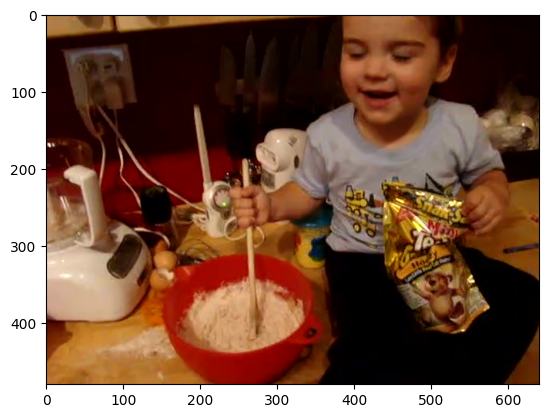

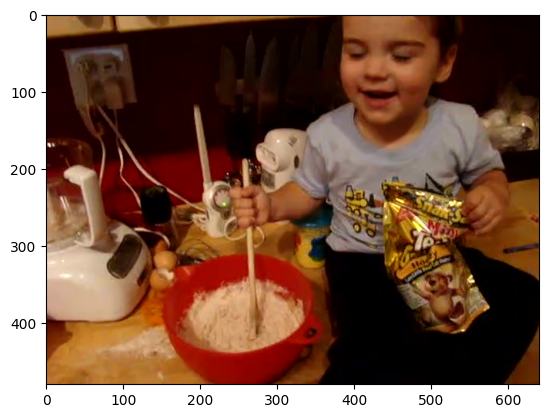

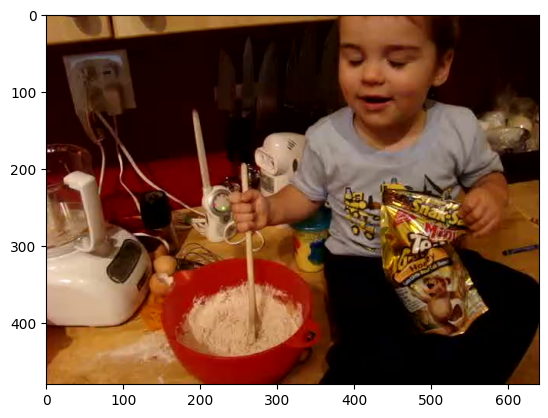

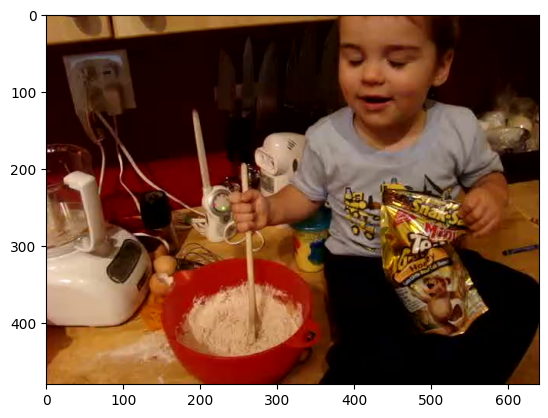

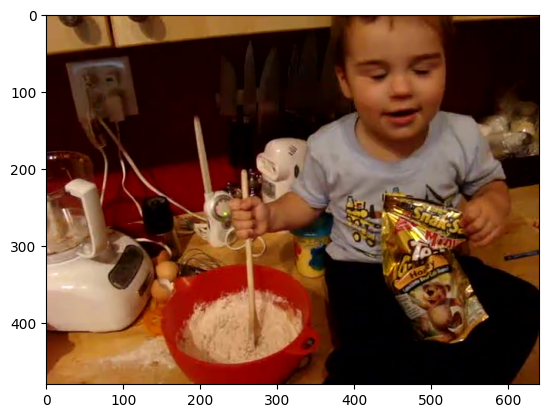

...

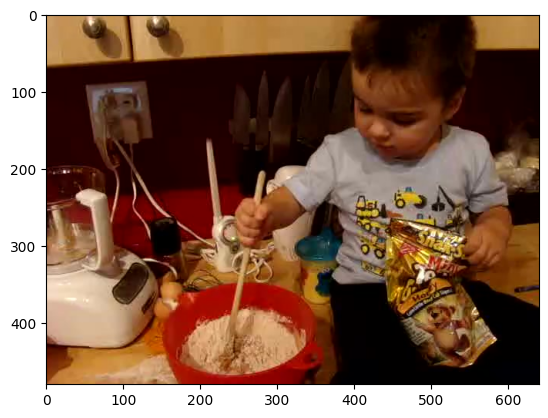

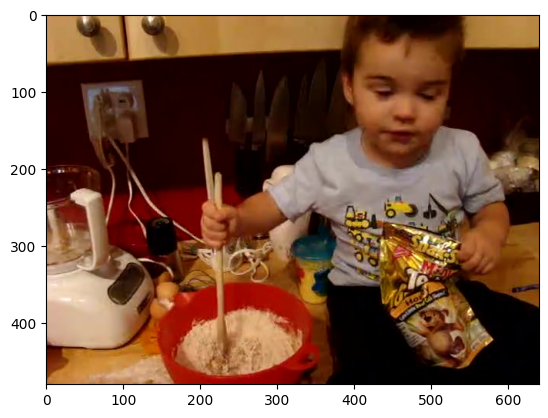

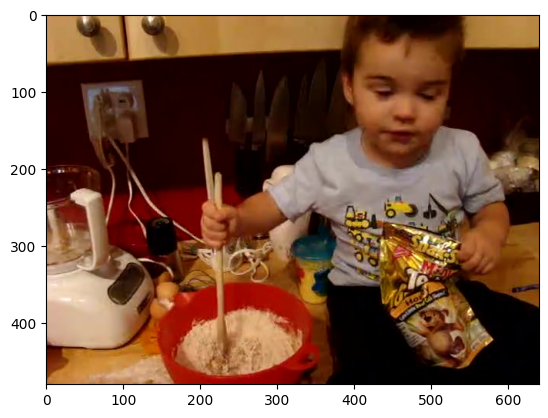

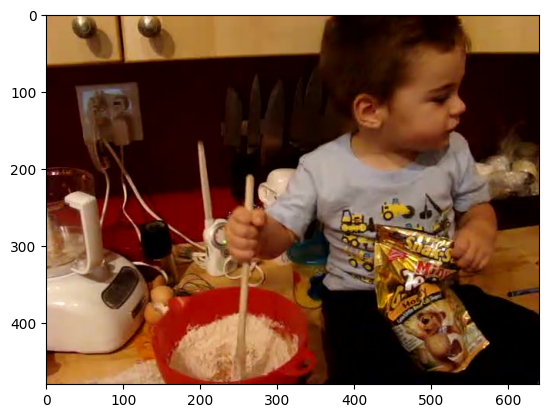

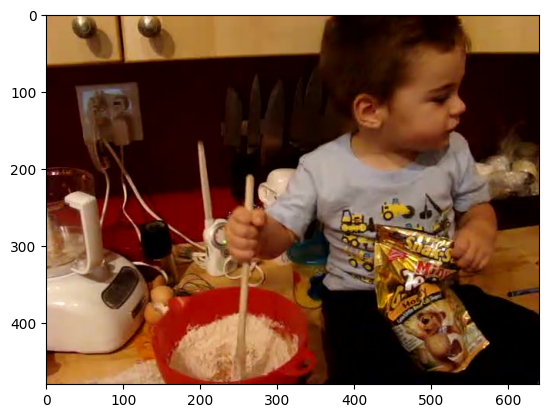

In [44]:
for vid in vid_list:
    image = Image.open(vid)
    plt.imshow(image)
    plt.show()